In [ ]:
%run supportvectors-common.ipynb

In [3]:
import umap
import numpy as np
import json
from typing import List
from svlearn.common.decorators import log_time_taken
from svlearn.common.log_config import LogConfiguration
from svlearn.common.svexception import SVError
from svlearn.common.utils import check_valid_file
from rich import print as rprint

import logging as logger
from svlearn.dimension.dimensionality_reduction import DimReducedLabeledVector, LabeledVector
from svlearn.dimension.umap_reduction import UmapDimensionalityReduction
from svlearn.dimension.pipeline import ChunkPipeline

from svlearn.ml.data import LabeledChunk
from svlearn.ml.sentence_encoder import SentenceEncoder

In [68]:
LogConfiguration().setup_logging(level=logger.DEBUG)
chunks_source = "/home/asif/chowkidar-data/zephyr.jsonl"
labeled_vectors_file = "/home/asif/chowkidar-data//labeled_vectors.jsonl"
reduced_vectors_file = "/home/asif/chowkidar-data/reduced_vectors.jsonl"
umap_model_file = "/home/asif/chowkidar-data/umap_model.joblib"

pipeline = ChunkPipeline()


In [69]:

#labeled_chunks = pipeline.read_labeled_chunks(chunks_source)
#labeled_vectors = pipeline.create_labeled_vectors(labeled_chunks)
#pipeline.write_labeled_vectors(labeled_vectors, labeled_vectors_file) 
pipeline.read_labeled_vectors(labeled_vectors_file)
test_labeled_vectors = pipeline.labeled_vectors[8*len(pipeline.labeled_vectors)//10:]
pipeline.labeled_vectors = test_labeled_vectors

#pipeline.reduce_dimensionality(supervised=True)
#pipeline.save_model(pipeline.reducer, umap_model_file)
pipeline.load_model(umap_model_file)

test_reduced_vectors = pipeline.reducer.transform(pipeline.labeled_vectors)

for vector in test_reduced_vectors[:10]:
    vector.vector = None
    rprint(vector)

----------------------------------------------------------------------------------------------------
 Time taken by read_labeled_vectors: 14.088592290878296 seconds
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
 Time taken by load_model: 1.207892656326294 seconds
----------------------------------------------------------------------------------------------------

In [32]:
pipeline.read_reduced_vectors(reduced_vectors_file)

----------------------------------------------------------------------------------------------------
 Time taken by read_reduced_vectors: 14.197974681854248 seconds
----------------------------------------------------------------------------------------------------

[LabeledVector(None, 'business_ethics', [ 0.06118582  0.02790804 -0.0322544  -0.0641294   0.03509326  0.05479553
   0.03002302  0.04127846  0.03116025  0.02902842  0.07925171  0.07657898
   0.03685896 -0.04580405 -0.02922652  0.10099469 -0.08527157  0.05058956
  -0.00570968 -0.00150561 -0.01369777 -0.03896722 -0.04242573  0.03401271
   0.07276182 -0.0128737  -0.02989873  0.00167163 -0.08729201 -0.01652231
   0.01262562 -0.02853349 -0.09212504 -0.09746682 -0.09158721  0.0064947
   0.03671372 -0.00405531  0.00017692 -0.0183891   0.03930866 -0.02271737
  -0.0488172  -0.00911183  0.02897323 -0.02039234 -0.01163367  0.04399692
   0.01780039 -0.03448714  0.00683189  0.0774819   0.01117285  0.07570397
   0.07699338  0.00395668 -0.04336092 -0.05228762  0.0381401   0.06845217
  -0.07447734 -0.03448186  0.00106204 -0.03321617  0.00072838 -0.03807217
   0.01546761  0.00582282 -0.01767769 -0.01365291 -0.00536141  0.05599434
  -0.01330867 -0.01714206  0.00719181 -0.04188982 -0.06856137  0.00241048


In [10]:
import umap.plot

In [15]:
#!pip install datashader bokeh holoviews

<Axes: >

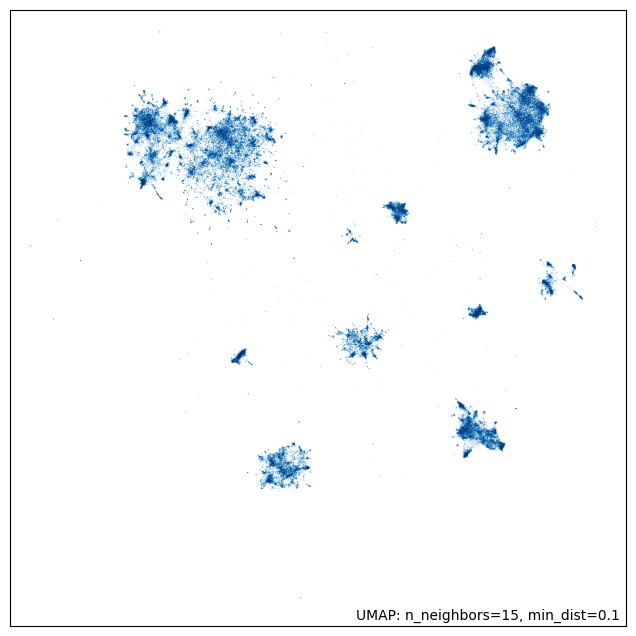

In [30]:
# umap.plot.points(pipeline.reducer.reducer, #labels=list(set([vector.y for vector in pipeline.reduced_vectors])), )

In [64]:
vectors = [v.reduced_vector for v in pipeline.reduced_vectors]

import plotly.express as px
fig = px.scatter(x=[v[0] for v in vectors], 
           y=[v[1] for v in vectors], 
           color=[v.y for v in pipeline.reduced_vectors],
           labels={'x':'UMAP 1', 'y':'UMAP 2'},
           
           title='UMAP 2D Projection of Labeled Vectors',
           width=1000,
           height=1000,
           opacity=0.3)
fig.update_traces(marker=dict(size=2))

In [60]:
import random
random.shuffle(pipeline.reduced_vectors)

# Now, let us perform a 80/20 split of the data, but first 
# we need to put it in the X, y format that scikit-learn expects

from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier

X = [v.reduced_vector for v in pipeline.reduced_vectors]
y = [v.y for v in pipeline.reduced_vectors]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)


In [61]:
classifier = KNeighborsClassifier(n_neighbors=25, n_jobs=-1 )
classifier.fit(X_train, y_train)
classifier.score(X_test, y_test)

0.9909755878080448

In [66]:
# Let us eliminate the outliers and see if the score improves
from sklearn.ensemble import IsolationForest
outlier_detector = IsolationForest(contamination=0.1)
outlier_detector.fit(X_train)
outliers = outlier_detector.predict(X_train)
outliers = [i for i, outlier in enumerate(outliers) if outlier == -1]
X_train = [X_train[i] for i in range(len(X_train)) if i not in outliers]
y_train = [y_train[i] for i in range(len(y_train)) if i not in outliers]

# likewise, let us remove outliers from the test set
outliers = outlier_detector.predict(X_test)
outliers = [i for i, outlier in enumerate(outliers) if outlier == -1]
X_test = [X_test[i] for i in range(len(X_test)) if i not in outliers]
y_test = [y_test[i] for i in range(len(y_test)) if i not in outliers]



In [67]:
# How does the training data look without the outliers?

fig = px.scatter(x=[v[0] for v in X_train],
              y=[v[1] for v in X_train],
              color=y_train,
              labels={'x':'UMAP 1', 'y':'UMAP 2'},
              title='UMAP 2D Projection of Labeled Vectors (Training Set)',
              width=1000,
              height=1000,
              opacity=0.3)
fig.update_traces(marker=dict(size=2))

In [58]:

classifier = KNeighborsClassifier(n_neighbors=25)
classifier.fit(X_train, y_train)
classifier.score(X_test, y_test)

0.9922388487148278

### What have we learned, tentatively?

1. A downward projection that is subject aware leads to a better classifier
2. Removing outliers marginally improves the results.
3. Trying it out for different splits gives the following results:

| split | accuracy | accuracy without outliers |
|-------| -------- | ------------------------- |
| 80/20 | 99.023%  |          99.184%          |
| 70/30 | 99.111%  |          99.268%          |
| 50/50 | 99.097%  |          99.224%          |



### Problems to fix (TODO)
1. Currently, we built the UMAP model out of the entire set; strictly, we should have
   done the test-train split, and then done the model training on a smaller dataset.

### Road ahead

The current work is the most basic version in pursuit of the hunch that a lower dimensional embedding will give better results. The client is awaiting for it, so there is a time-pressure. 

Since it is encouraging to pursue this line of enquiry, we need to take it deeper **some day**
